# Artificial Neural Networks and Deep Learning - Homework 1















- Team: Bio.log(y)







- Members: Luca Lepore, Arianna Rigamonti, Michele Sala, Jacopo Libero Tettamanti















---















## MobileNetV3 on pre-processed data

### ⚙️ Import Libraries

In [1]:
# Set seed for reproducibility
seed = 42

# Import necessary libraries
import os

# Set environment variables before importing modules
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
os.environ['PYTHONHASHSEED'] = str(seed)
os.environ['MPLCONFIGDIR'] = os.getcwd() + '/configs/'

# Suppress warnings
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=Warning)

# Import necessary modules
import logging
import random
import numpy as np
import pandas as pd

# Set seeds for random number generators in NumPy and Python
np.random.seed(seed)
random.seed(seed)

# Import TensorFlow and Keras
import tensorflow as tf
import keras as tfk
from keras.layers import Input, Dense, Dropout, Lambda
from keras import layers as tfkl
import keras_cv.layers as cv_layers

# Set seed for TensorFlow
tf.random.set_seed(seed)
tf.compat.v1.set_random_seed(seed)

# Reduce TensorFlow verbosity
tf.autograph.set_verbosity(0)
tf.get_logger().setLevel(logging.ERROR)
tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR)

# Print TensorFlow version
print(f"TensorFlow version: {tf.__version__}")
print(f"Keras version: {tfk.__version__}")

# Import other libraries
import cv2
from tensorflow.keras.applications.mobilenet import preprocess_input
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, confusion_matrix
from PIL import Image
import matplotlib.gridspec as gridspec
import requests
from io import BytesIO
from sklearn.utils import resample, shuffle
from sklearn.utils.class_weight import compute_class_weight
from ipywidgets import interact, IntSlider, Dropdown
from tensorflow.keras.utils import to_categorical
import plotly.express as px
import imagehash
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

# Configure plot display settings
sns.set(font_scale=1.4)
sns.set_style('white')
plt.rc('font', size=14)
%matplotlib inline

TensorFlow version: 2.16.1
Keras version: 3.3.3


## ⏳ Load Data

In [2]:
# Load your dataset
train_augmented = np.load('/kaggle/input/images/X_train_augmented_3x.npz')
X_train = train_augmented['images']
y_train = train_augmented['labels']

val_augmented = np.load('/kaggle/input/images/X_val_augmented_3x.npz')
X_val = val_augmented['images']
y_val = val_augmented['labels']

test = np.load('/kaggle/input/images/X_test.npz')
X_test = test['images']
y_test = test['labels']

test_augmented = np.load('/kaggle/input/images/X_test_augmented_4x.npz')
X_test_augmented = test_augmented['images']
y_test_augmented = test_augmented['labels']

# Define class labels
labels = {0: "Basophil", 1: "Eosinophil", 2: "Erythroblast", 3: "Immature granulocytes",
          4: "Lymphocyte", 5: "Monocyte", 6: "Neutrophil", 7: "Platelet"}

# Save unique labels
unique_labels = list(labels.values())
print(f'Unique labels: {unique_labels}')

Unique labels: ['Basophil', 'Eosinophil', 'Erythroblast', 'Immature granulocytes', 'Lymphocyte', 'Monocyte', 'Neutrophil', 'Platelet']


In [3]:
# Check the shape of the loaded images
print(f"Loaded X_train images shape: {X_train.shape}")
print(f"Loaded y_train labels shape: {y_train.shape}")
print(f"Min value X_train: {X_train.min()}, Max value X_train: {X_train.max()}\n")

print(f"Loaded X_val images shape: {X_val.shape}")
print(f"Loaded y_val labels shape: {y_val.shape}")
print(f"Min value X_val: {X_val.min()}, Max value X_val: {X_val.max()}\n")

print(f"Loaded X_test images shape: {X_test.shape}")
print(f"Loaded y_test labels shape: {y_test.shape}")
print(f"Min value X_test: {X_test.min()}, Max value X_test: {X_test.max()}\n")

print(f"Loaded X_test_augmented images shape: {X_test_augmented.shape}")
print(f"Loaded y_test_augmented labels shape: {y_test_augmented.shape}")
print(f"Min value X_test_augmented: {X_test_augmented.min()}, Max value X_test_augmented: {X_test_augmented.max()}")

Loaded X_train images shape: (21513, 96, 96, 3)
Loaded y_train labels shape: (21513, 8)
Min value X_train: 0.0, Max value X_train: 255.0

Loaded X_val images shape: (7173, 96, 96, 3)
Loaded y_val labels shape: (7173, 8)
Min value X_val: 0.0, Max value X_val: 255.0

Loaded X_test images shape: (2391, 96, 96, 3)
Loaded y_test labels shape: (2391, 8)
Min value X_test: 0, Max value X_test: 255

Loaded X_test_augmented images shape: (9564, 96, 96, 3)
Loaded y_test_augmented labels shape: (9564, 8)
Min value X_test_augmented: 0.0, Max value X_test_augmented: 255.0


## 🔎 Inspect Data

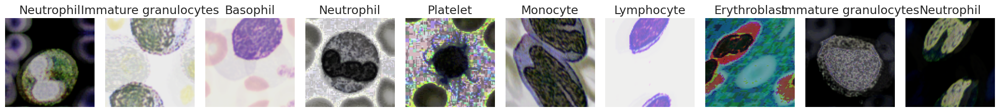

In [4]:
# Number of images to display
num_img = 10

# Set a random seed for reproducibility
random.seed(seed)

# Select random indices
random_indices = random.sample(range(len(X_train)), num_img)

# Create subplots
fig, axes = plt.subplots(1, num_img, figsize=(20, 5))

for i, idx in enumerate(random_indices):
    ax = axes[i]
    
    # Get the image and cast it to uint8
    image = X_train[idx]
    image_uint8 = (image).astype(np.uint8)
    
    # Handle color and grayscale images
    if image_uint8.shape[-1] == 1:
        image_uint8 = np.squeeze(image_uint8, axis=-1)
        ax.imshow(image_uint8, cmap='gray', vmin=0, vmax=255)
    else:
        ax.imshow(image_uint8)

    # Set the title based on the label
    label_index = np.argmax(y_train[idx])
    label = labels[label_index]
    
    ax.set_title(f'{label}')
    ax.axis('off')

plt.tight_layout()
plt.show()

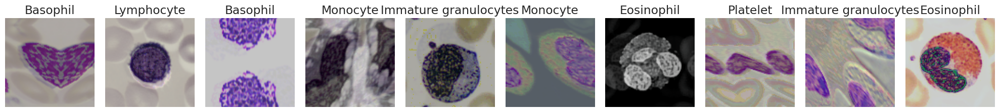

In [5]:
# Number of images to display
num_img = 10

# Set a random seed for reproducibility
random.seed(seed)

# Select random indices
random_indices = random.sample(range(len(X_val)), num_img)

# Create subplots
fig, axes = plt.subplots(1, num_img, figsize=(20, 5))

for i, idx in enumerate(random_indices):
    ax = axes[i]

    # Get the image and cast it to uint8
    image = X_val[idx]
    image_uint8 = (image).astype(np.uint8)

    # Handle color and grayscale images
    if image_uint8.shape[-1] == 1:
        image_uint8 = np.squeeze(image_uint8, axis=-1)
        ax.imshow(image_uint8, cmap='gray', vmin=0, vmax=255)
    else:
        ax.imshow(image_uint8)

    # Set the title based on the label
    label_index = np.argmax(y_val[idx])
    label = labels[label_index]
    ax.set_title(f'{label}')
    ax.axis('off')

plt.tight_layout()
plt.show()

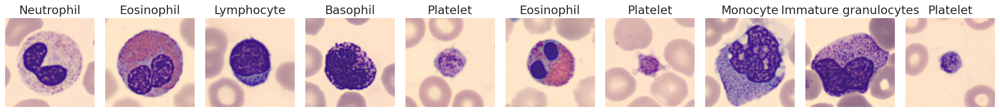

In [6]:
# Number of images to display
num_img = 10

# Set a random seed for reproducibility
random.seed(seed)

# Select random indices
random_indices = random.sample(range(len(X_test)), num_img)

# Create subplots
fig, axes = plt.subplots(1, num_img, figsize=(20, 5))

for i, idx in enumerate(random_indices):
    ax = axes[i]

    # Get the image and cast it to uint8
    image = X_test[idx]
    image_uint8 = (image).astype(np.uint8)

    # Handle color and grayscale images
    if image_uint8.shape[-1] == 1:
        image_uint8 = np.squeeze(image_uint8, axis=-1)
        ax.imshow(image_uint8, cmap='gray', vmin=0, vmax=255)
    else:
        ax.imshow(image_uint8)

    # Set the title based on the label
    label_index = np.argmax(y_test[idx])
    label = labels[label_index]
    ax.set_title(f'{label}')
    ax.axis('off')

plt.tight_layout()
plt.show()

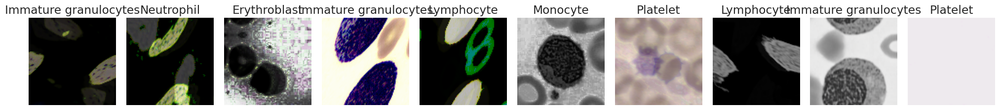

In [7]:
# Number of images to display
num_img = 10

# Set a random seed for reproducibility
random.seed(seed)

# Select random indices
random_indices = random.sample(range(len(X_test_augmented)), num_img)

# Create subplots
fig, axes = plt.subplots(1, num_img, figsize=(20, 5))

for i, idx in enumerate(random_indices):
    ax = axes[i]

    # Get the image and cast it to uint8
    image = X_test_augmented[idx]
    image_uint8 = (image).astype(np.uint8)

    # Handle color and grayscale images
    if image_uint8.shape[-1] == 1:
        image_uint8 = np.squeeze(image_uint8, axis=-1)
        ax.imshow(image_uint8, cmap='gray', vmin=0, vmax=255)
    else:
        ax.imshow(image_uint8)

    # Set the title based on the label
    label_index = np.argmax(y_test_augmented[idx])
    label = labels[label_index]
    ax.set_title(f'{label}')
    ax.axis('off')

plt.tight_layout()
plt.show()

### Class balancing

In [8]:
# Flatten the labels to class indices since they're in one-hot encoding
y_train_flat = np.argmax(y_train, axis=1)

# Calculate class weights
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.unique(y_train_flat),
    y=y_train_flat
)

# Convert the class weights to a dictionary
class_weight_dict = dict(enumerate(class_weights))

# Print the calculated class weights
print("Class weights:")
for class_index, weight in class_weight_dict.items():
    print(f"Class {class_index}: Weight {weight:.2f}")

Class weights:
Class 0: Weight 1.75
Class 1: Weight 0.69
Class 2: Weight 1.38
Class 3: Weight 0.74
Class 4: Weight 1.76
Class 5: Weight 1.50
Class 6: Weight 0.64
Class 7: Weight 0.91


## 🧮 Define Network Parameters

In [9]:
# Input shape for the model
input_shape = X_train.shape[1:]

# Output shape for the model
output_shape = y_train.shape[1]

print("Input Shape:", input_shape)
print("Output Shape:", output_shape)

Input Shape: (96, 96, 3)
Output Shape: 8


In [10]:
# Number of training epochs
epochs = 200

# Batch size for training
batch_size = 64

# Print the defined parameters
print("Epochs:", epochs)
print("Batch Size:", batch_size)

Epochs: 200
Batch Size: 64


## **Inverted Residual Bottleneck with SE (MobileNetV3, 2019)**















<img src="https://www.researchgate.net/publication/378806327/figure/fig5/AS:11431281232045939@1711587010842/MobileNetV3-network-structure.jpg" width="600"/>























---







**Key Features and Achievements**























*   Pioneered platform-aware Neural Architecture Search (NAS)







*   Introduced hardware-aware network design







*   Combined manual design with automated search







*   Optimized for mobile inference latency















**Key building block:**















*   "Enhanced" Inverted Residual Block (Expansion ratio tuned per block, SE module redesigned for efficiency, Hard-Swish activation function(h-swish))







*   Efficient last stage design (Reduced channels in first layer, moved SE to cheaper layers, platform-aware operator selection)















**Impact:**















*   Set new SOTA for mobile networks







*   Demonstrated successful NAS and human design fusion







*   Showed importance of hardware-aware architecture design







*   Influenced automated architecture search methods















**📜 Paper:** ["Searching for MobileNetV3", Howard et al.](https://arxiv.org/pdf/1905.02244)















---















<img src="https://drive.google.com/uc?export=view&id=1EcBp60nEorTDLROT_1L4a4Mvw9kLdKqd" width="300"/>

## 🛠️ Transfer Learning















<img src="https://radekosmulski.com/content/images/2021/08/imagenet_banner.jpeg" width="700"/>

In [11]:
# Initialise MobileNetV3Small model with pretrained weights, for transfer learning
weights_path = '/kaggle/input/weight2/weights_mobilenet_v3_small_224_1.0_float_no_top_v2.h5'

mobilenet = tfk.applications.MobileNetV3Small(
    input_shape=input_shape,
    include_top=False,
    weights=weights_path,
    pooling='avg',
    include_preprocessing=True
)

Model: "MobilenetV3small"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 96, 96, 3) │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling           │ (None, 96, 96, 3) │          0 │ input_layer[0][0] │
│ (Rescaling)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv (Conv2D)       │ (None, 48, 48,    │        432 │ rescaling[0][0]   │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv_bn             │ (None, 48, 48,    │         64 │ conv[0][0]        │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, 48, 48,    │          0 │ conv_bn[0][0]     │
│ (Activation)        │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 49, 49,    │          0 │ activation[0][0]  │
│ (ZeroPadding2D)     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 24, 24,    │        144 │ expanded_conv_de… │
│ (DepthwiseConv2D)   │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 24, 24,    │         64 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu (ReLU)        │ (None, 24, 24,    │          0 │ expanded_conv_de… │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_sque… │ (None, 1, 1, 16)  │          0 │ re_lu[0][0]       │
│ (GlobalAveragePool… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_sque… │ (None, 1, 1, 8)   │        136 │ expanded_conv_sq… │
│ (Conv2D)            │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_sque… │ (None, 1, 1, 8)   │          0 │ expanded_conv_sq… │
│ (ReLU)              │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_sque… │ (None, 1, 1, 16)  │        144 │ expanded_conv_sq… │
│ (Conv2D)            │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, 1, 1, 16)  │          0 │ expanded_conv_sq… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_1 (ReLU)      │ (None, 1, 1, 16)  │          0 │ add[0][0]         │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multiply (Multiply) │ (None, 1, 1, 16)  │          0 │ re_lu_1[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_sque… │ (None, 24, 24,    │          0 │ re_lu[0][0],      │
│ (Multiply)          │ 16)               │            │ multiply[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 24, 24,    │        256 │ expanded_conv_sq

 Total params: 939,120 (3.58 MB)

 Trainable params: 927,008 (3.54 MB)

 Non-trainable params: 12,112 (47.31 KB)

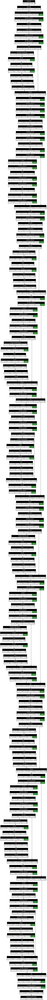

In [12]:
# Display a summary of the model architecture
mobilenet.summary(expand_nested=True)

# Display model architecture with layer shapes and trainable parameters
tfk.utils.plot_model(mobilenet, expand_nested=True, show_trainable=True, show_shapes=True, dpi=70)

#### Model with 1 dense layer

In [13]:
# Freeze all layers in MobileNetV3Small to use it solely as a feature extractor
mobilenet.trainable = False

# Define input layer with shape matching the input images
inputs = tfk.Input(shape=input_shape, name='input_layer')

# Pass inputs through the MobileNetV3Small feature extractor
x = mobilenet(inputs)
print("Shape after MobileNetV3Small:", x.shape)

# Add a Dropout layer for regularisation
x = tfkl.Dropout(0.3, name='dropout1')(x)
print("Shape after Dropout1:", x.shape)

# Add a final Dense layer for classification with softmax activation
outputs = tfkl.Dense(y_train.shape[-1], activation='softmax', name='dense3')(x)
print("Shape after Dense1:", outputs.shape)

# Define the complete model linking input and output
tl_model1 = tfk.Model(inputs=inputs, outputs=outputs, name='model1')

# Compile the model with categorical cross-entropy loss and Adam optimiser
tl_model1.compile(loss=tfk.losses.CategoricalCrossentropy(), optimizer=tfk.optimizers.Adam(), metrics=['accuracy'])  # default learning rate = 0.001

Shape after MobileNetV3Small: (None, 576)
Shape after Dropout1: (None, 576)
Shape after Dense1: (None, 8)


Model: "model1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 96, 96, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ MobilenetV3small (Functional)   │ (None, 576)            │       939,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout1 (Dropout)              │ (None, 576)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense3 (Dense)                  │ (None, 8)              │         4,616 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 943,736 (3.60 MB)

 Trainable params: 4,616 (18.03 KB)

 Non-trainable params: 939,120 (3.58 MB)

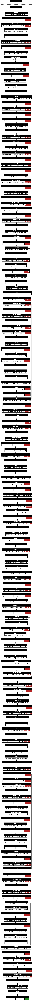

In [14]:
# Display a summary of the model architecture
tl_model1.summary()

# Display model architecture with layer shapes and trainable parameters
tfk.utils.plot_model(tl_model1, expand_nested=True, show_trainable=True, show_shapes=True, dpi=70)

#### Model with 2 dense layer

In [15]:
# Freeze all layers in MobileNetV3Small to use it solely as a feature extractor
mobilenet.trainable = False

# Define input layer with shape matching the input images
inputs = tfk.Input(shape=input_shape, name='input_layer')

# Pass inputs through the MobileNetV3Small feature extractor
x = mobilenet(inputs)
print("Shape after MobileNetV3Small:", x.shape)

# Add a Dense layer without activation
x = tfkl.Dense(512, name='dense1')(x)
print("Shape after Dense1:", x.shape)

# Add Batch Normalization
x = tfkl.BatchNormalization(name='batch_norm1')(x)
print("Shape after BatchNorm1:", x.shape)

# Add ReLU activation
x = tfkl.Activation('relu', name='activation1')(x)
print("Shape after Activation1:", x.shape)

# Add a Dropout layer for regularisation
x = tfkl.Dropout(0.5, name='dropout1')(x)
print("Shape after Dropout1:", x.shape)

# Add final Dense layer for classification with softmax activation
outputs = tfkl.Dense(y_train.shape[-1], activation='softmax', name='dense3')(x)
print("Shape after Dense3:", outputs.shape)

# Define the complete model linking input and output
tl_model2 = tfk.Model(inputs=inputs, outputs=outputs, name='model2')

# Compile the model with categorical cross-entropy loss and Adam optimiser
tl_model2.compile(loss=tfk.losses.CategoricalCrossentropy(), optimizer=tfk.optimizers.Adam(), metrics=['accuracy'])  # default learning rate = 0.001

Shape after MobileNetV3Small: (None, 576)
Shape after Dense1: (None, 512)
Shape after BatchNorm1: (None, 512)
Shape after Activation1: (None, 512)
Shape after Dropout1: (None, 512)
Shape after Dense3: (None, 8)


Model: "model2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 96, 96, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ MobilenetV3small (Functional)   │ (None, 576)            │       939,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense1 (Dense)                  │ (None, 512)            │       295,424 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_norm1                     │ (None, 512)            │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation1 (Activation)        │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout1 (Dropout)              │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense3 (Dense)                  │ (None, 8)              │         4,104 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,240,696 (4.73 MB)

 Trainable params: 300,552 (1.15 MB)

 Non-trainable params: 940,144 (3.59 MB)

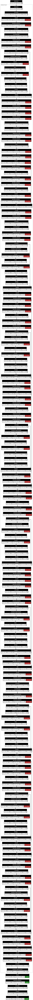

In [16]:
# Display a summary of the model architecture
tl_model2.summary()

# Display model architecture with layer shapes and trainable parameters
tfk.utils.plot_model(tl_model2, expand_nested=True, show_trainable=True, show_shapes=True, dpi=70)

#### Model with 3 dense layers

In [17]:
# Freeze all layers in MobileNetV3Small to use it solely as a feature extractor
mobilenet.trainable = False

# Define input layer with shape matching the input images
inputs = tfk.Input(shape=input_shape, name='input_layer')

# Pass inputs through the MobileNetV3Small feature extractor
x = mobilenet(inputs)
print("Shape after MobileNetV3Small:", x.shape)

# Add a Dense layer without activation
x = tfkl.Dense(512, name='dense1')(x)
print("Shape after Dense1:", x.shape)

# Add Batch Normalization
x = tfkl.BatchNormalization(name='batch_norm1')(x)
print("Shape after BatchNorm1:", x.shape)

# Add ReLU activation
x = tfkl.Activation('relu', name='activation1')(x)
print("Shape after Activation1:", x.shape)

# Add a Dropout layer for regularisation
x = tfkl.Dropout(0.5, name='dropout1')(x)
print("Shape after Dropout1:", x.shape)

# Add another Dense layer without activation
x = tfkl.Dense(256, name='dense2')(x)
print("Shape after Dense2:", x.shape)

# Add Batch Normalization
x = tfkl.BatchNormalization(name='batch_norm2')(x)
print("Shape after BatchNorm2:", x.shape)

# Add ReLU activation
x = tfkl.Activation('relu', name='activation2')(x)
print("Shape after Activation2:", x.shape)

# Add another Dropout layer for regularisation
x = tfkl.Dropout(0.5, name='dropout2')(x)
print("Shape after Dropout2:", x.shape)

# Add final Dense layer for classification with softmax activation
outputs = tfkl.Dense(y_train.shape[-1], activation='softmax', name='dense3')(x)
print("Shape after Dense3:", outputs.shape)

# Define the complete model linking input and output
tl_model3 = tfk.Model(inputs=inputs, outputs=outputs, name='model3')

# Compile the model with categorical cross-entropy loss and Adam optimiser
tl_model3.compile(loss=tfk.losses.CategoricalCrossentropy(), optimizer=tfk.optimizers.Adam(), metrics=['accuracy'])  # default learning rate = 0.001

Shape after MobileNetV3Small: (None, 576)
Shape after Dense1: (None, 512)
Shape after BatchNorm1: (None, 512)
Shape after Activation1: (None, 512)
Shape after Dropout1: (None, 512)
Shape after Dense2: (None, 256)
Shape after BatchNorm2: (None, 256)
Shape after Activation2: (None, 256)
Shape after Dropout2: (None, 256)
Shape after Dense3: (None, 8)


Model: "model3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 96, 96, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ MobilenetV3small (Functional)   │ (None, 576)            │       939,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense1 (Dense)                  │ (None, 512)            │       295,424 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_norm1                     │ (None, 512)            │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation1 (Activation)        │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout1 (Dropout)              │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense2 (Dense)                  │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_norm2                     │ (None, 256)            │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation2 (Activation)        │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout2 (Dropout)              │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense3 (Dense)                  │ (None, 8)              │         2,056 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,371,000 (5.23 MB)

 Trainable params: 430,344 (1.64 MB)

 Non-trainable params: 940,656 (3.59 MB)

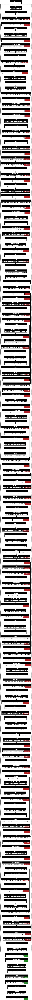

In [18]:
# Display a summary of the model architecture
tl_model3.summary()

# Display model architecture with layer shapes and trainable parameters
tfk.utils.plot_model(tl_model3, expand_nested=True, show_trainable=True, show_shapes=True, dpi=70)

In [19]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(
    monitor='val_accuracy',       # Metric to monitor
    mode='max',                   # Mode ('max' for accuracy)
    patience=20,                  # Number of epochs with no improvement before stopping
    restore_best_weights=True     # Restore the model weights from the epoch with the best value of the monitored metric
)

In [20]:
# Define the ReduceLROnPlateau callback
reduce_lr = ReduceLROnPlateau(
    monitor='val_loss',           # Metric to monitor
    factor=0.5,                   # Factor by which the learning rate will be reduced
    patience=5,                   # Number of epochs with no improvement before reducing learning rate
    verbose=1,                    # Verbosity mode (0 = silent, 1 = updates messages)
    min_lr=1e-6                   # Lower bound on the learning rate
)

In [21]:
# Train the model 1
tl_history1 = tl_model1.fit(
    x=X_train,
    y=y_train,
    batch_size=batch_size,
    epochs=epochs,
    validation_data=(X_val, y_val),
    class_weight=class_weight_dict,
    callbacks=[early_stopping, reduce_lr]
).history

# Calculate and print the best validation accuracy achieved
final_val_accuracy1 = round(max(tl_history1['val_accuracy']) * 100, 2)
print(f'Final validation accuracy 1: {final_val_accuracy1}%')

# Save the trained model to a file, including final accuracy in the filename
model_filename = f'MobileNetV3S_{final_val_accuracy1}.keras'
tl_model1.save(model_filename)

# Free memory by deleting the model instance
del tl_model1

Epoch 1/200


I0000 00:00:1732460596.755103      97 service.cc:145] XLA service 0x79cd08072000 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1732460596.755173      97 service.cc:153]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0


 21/337 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.1196 - loss: 2.6840

I0000 00:00:1732460602.514639      97 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


337/337 ━━━━━━━━━━━━━━━━━━━━ 25s 44ms/step - accuracy: 0.2917 - loss: 2.0095 - val_accuracy: 0.5560 - val_loss: 1.2726 - learning_rate: 0.0010
Epoch 2/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.5140 - loss: 1.3725 - val_accuracy: 0.5907 - val_loss: 1.1832 - learning_rate: 0.0010
Epoch 3/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.5469 - loss: 1.2812 - val_accuracy: 0.6004 - val_loss: 1.1618 - learning_rate: 0.0010
Epoch 4/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.5619 - loss: 1.2381 - val_accuracy: 0.6030 - val_loss: 1.1418 - learning_rate: 0.0010
Epoch 5/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.5742 - loss: 1.2214 - val_accuracy: 0.6102 - val_loss: 1.1212 - learning_rate: 0.0010
Epoch 6/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.5751 - loss: 1.2111 - val_accuracy: 0.6084 - val_loss: 1.1249 - learning_rate: 0.0010
Epoch 7/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.5771 - loss: 1.2047

In [22]:
# Train the model 2
tl_history2 = tl_model2.fit(
    x=X_train,
    y=y_train,
    batch_size=batch_size,
    epochs=epochs,
    validation_data=(X_val, y_val),
    class_weight=class_weight_dict,
    callbacks=[early_stopping, reduce_lr]
).history

# Calculate and print the best validation accuracy achieved
final_val_accuracy2 = round(max(tl_history2['val_accuracy']) * 100, 2)
print(f'Final validation accuracy 2: {final_val_accuracy2}%')

# Save the trained model to a file, including final accuracy in the filename
model_filename = f'MobileNetV3S_{final_val_accuracy2}.keras'
tl_model2.save(model_filename)

# Free memory by deleting the model instance
del tl_model2

Epoch 1/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 22s 41ms/step - accuracy: 0.4370 - loss: 1.6743 - val_accuracy: 0.6057 - val_loss: 1.0919 - learning_rate: 0.0010
Epoch 2/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.5973 - loss: 1.1244 - val_accuracy: 0.6216 - val_loss: 1.0408 - learning_rate: 0.0010
Epoch 3/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.6411 - loss: 1.0173 - val_accuracy: 0.6354 - val_loss: 0.9966 - learning_rate: 0.0010
Epoch 4/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.6608 - loss: 0.9424 - val_accuracy: 0.6373 - val_loss: 1.0032 - learning_rate: 0.0010
Epoch 5/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.6807 - loss: 0.8942 - val_accuracy: 0.6452 - val_loss: 0.9950 - learning_rate: 0.0010
Epoch 6/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.6903 - loss: 0.8531 - val_accuracy: 0.6453 - val_loss: 0.9969 - learning_rate: 0.0010
Epoch 7/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7074 - 

In [23]:
# Train the model 3
tl_history3 = tl_model3.fit(
    x=X_train,
    y=y_train,
    batch_size=batch_size,
    epochs=epochs,
    validation_data=(X_val, y_val),
    class_weight=class_weight_dict,
    callbacks=[early_stopping, reduce_lr]
).history

# Calculate and print the best validation accuracy achieved
final_val_accuracy3 = round(max(tl_history3['val_accuracy']) * 100, 2)
print(f'Final validation accuracy 3: {final_val_accuracy3}%')

# Save the trained model to a file, including final accuracy in the filename
model_filename = f'MobileNetV3S_{final_val_accuracy3}.keras'
tl_model3.save(model_filename)

# Free memory by deleting the model instance
del tl_model3

Epoch 1/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 26s 44ms/step - accuracy: 0.3675 - loss: 1.8471 - val_accuracy: 0.5802 - val_loss: 1.1472 - learning_rate: 0.0010
Epoch 2/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.5466 - loss: 1.2750 - val_accuracy: 0.5992 - val_loss: 1.0702 - learning_rate: 0.0010
Epoch 3/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.5914 - loss: 1.1419 - val_accuracy: 0.6123 - val_loss: 1.0342 - learning_rate: 0.0010
Epoch 4/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.6141 - loss: 1.0806 - val_accuracy: 0.6373 - val_loss: 0.9933 - learning_rate: 0.0010
Epoch 5/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.6320 - loss: 1.0203 - val_accuracy: 0.6325 - val_loss: 0.9924 - learning_rate: 0.0010
Epoch 6/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.6426 - loss: 0.9814 - val_accuracy: 0.6313 - val_loss: 1.0001 - learning_rate: 0.0010
Epoch 7/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.6570 - 

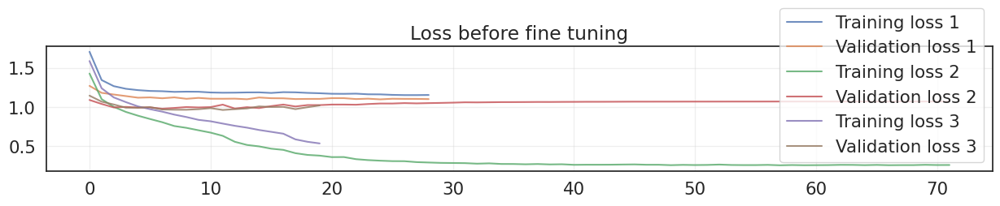

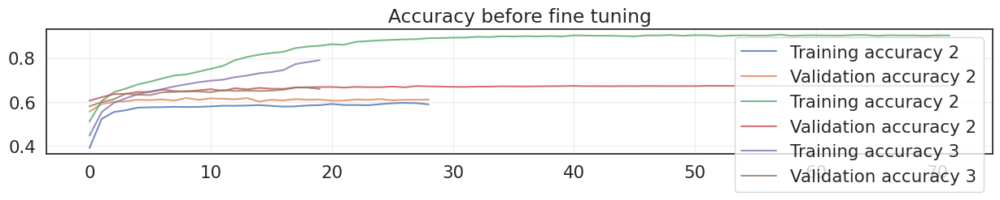

In [24]:
# Plot training and validation loss
plt.figure(figsize=(15, 2))
plt.plot(tl_history1['loss'], label='Training loss 1', alpha=.8)
plt.plot(tl_history1['val_loss'], label='Validation loss 1', alpha=.8)
plt.plot(tl_history2['loss'], label='Training loss 2', alpha=.8)
plt.plot(tl_history2['val_loss'], label='Validation loss 2', alpha=.8)
plt.plot(tl_history3['loss'], label='Training loss 3', alpha=.8)
plt.plot(tl_history3['val_loss'], label='Validation loss 3', alpha=.8)
plt.title('Loss before fine tuning')
plt.legend()
plt.grid(alpha=.3)

# Plot training and validation accuracy
plt.figure(figsize=(15, 2))
plt.plot(tl_history1['accuracy'], label='Training accuracy 2', alpha=.8)
plt.plot(tl_history1['val_accuracy'], label='Validation accuracy 2', alpha=.8)
plt.plot(tl_history2['accuracy'], label='Training accuracy 2', alpha=.8)
plt.plot(tl_history2['val_accuracy'], label='Validation accuracy 2', alpha=.8)
plt.plot(tl_history3['accuracy'], label='Training accuracy 3', alpha=.8)
plt.plot(tl_history3['val_accuracy'], label='Validation accuracy 3', alpha=.8)
plt.title('Accuracy before fine tuning')
plt.legend()
plt.grid(alpha=.3)

plt.show()

## 🛠️ Fine Tuning















<img src="https://www.researchgate.net/publication/359405075/figure/fig2/AS:1182999492214798@1659060466845/Concept-of-fine-tuning-and-feature-extraction_W640.jpg" width="700"/>


In [26]:
# Re-load the model after transfer learning
ft_model1 = tfk.models.load_model('/kaggle/working/MobileNetV3S_61.79.keras') # model 1
ft_model2 = tfk.models.load_model('/kaggle/working/MobileNetV3S_67.34.keras') # model 2
ft_model3 = tfk.models.load_model('/kaggle/working/MobileNetV3S_66.56.keras') # model 3

In [27]:
# Set the MobileNetV3Small model layers as trainable
ft_model1.get_layer('MobilenetV3small').trainable = True
ft_model2.get_layer('MobilenetV3small').trainable = True
ft_model3.get_layer('MobilenetV3small').trainable = True

In [28]:
def print_model_layers(model, base_model_name):
    """
    Print the number of layers, their names, and their trainability status for a given model.

    Args:
        model: The TensorFlow/Keras model.
        base_model_name: The name of the base model layer (e.g., 'MobilenetV3small').
    """
    base_model = model.get_layer(base_model_name)
    layers = base_model.layers
    print(f"Total number of layers in '{base_model_name}': {len(layers)}\n")
    
    print("Index | Layer Name                      | Trainable")
    print("-------------------------------------------------")
    for i, layer in enumerate(layers):
        print(f"{i:<6} | {layer.name:<30} | {layer.trainable}")

print_model_layers(ft_model1, 'MobilenetV3small')

Total number of layers in 'MobilenetV3small': 158

Index | Layer Name                      | Trainable
-------------------------------------------------
0      | input_layer                    | True
1      | rescaling                      | True
2      | conv                           | True
3      | conv_bn                        | True
4      | activation                     | True
5      | expanded_conv_depthwise_pad    | True
6      | expanded_conv_depthwise        | True
7      | expanded_conv_depthwise_bn     | True
8      | re_lu                          | True
9      | expanded_conv_squeeze_excite_avg_pool | True
10     | expanded_conv_squeeze_excite_conv | True
11     | expanded_conv_squeeze_excite_relu | True
12     | expanded_conv_squeeze_excite_conv_1 | True
13     | re_lu_1                        | True
14     | expanded_conv_squeeze_excite_mul | True
15     | expanded_conv_project          | True
16     | expanded_conv_project_bn       | True
17     | expanded_conv_1_exp

In [29]:
# Set the number of layers to freeze
N = 109  # to be adjusted based on the model

# Set the first N layers as non-trainable
for i, layer in enumerate(ft_model1.get_layer('MobilenetV3small').layers[:N]):
    layer.trainable = False

# Set the BatchNorm layers as non-trainable
for layer in ft_model1.get_layer('MobilenetV3small').layers:
    if isinstance(layer, tf.keras.layers.BatchNormalization):
        layer.trainable = False

# Set the first N layers as non-trainable
for i, layer in enumerate(ft_model2.get_layer('MobilenetV3small').layers[:N]):
    layer.trainable = False

# Set the BatchNorm layers as non-trainable
for layer in ft_model2.get_layer('MobilenetV3small').layers:
    if isinstance(layer, tf.keras.layers.BatchNormalization):
        layer.trainable = False

for i, layer in enumerate(ft_model3.get_layer('MobilenetV3small').layers[:N]):
    layer.trainable = False

# Set the BatchNorm layers as non-trainable
for layer in ft_model3.get_layer('MobilenetV3small').layers:
    if isinstance(layer, tf.keras.layers.BatchNormalization):
        layer.trainable = False

# Print layer indices, names, and trainability status
for i, layer in enumerate(ft_model1.get_layer('MobilenetV3small').layers):
    print(i, layer.name, layer.trainable)
    
for i, layer in enumerate(ft_model2.get_layer('MobilenetV3small').layers):
    print(i, layer.name, layer.trainable)

for i, layer in enumerate(ft_model3.get_layer('MobilenetV3small').layers):
    print(i, layer.name, layer.trainable)

0 input_layer False
1 rescaling False
2 conv False
3 conv_bn False
4 activation False
5 expanded_conv_depthwise_pad False
6 expanded_conv_depthwise False
7 expanded_conv_depthwise_bn False
8 re_lu False
9 expanded_conv_squeeze_excite_avg_pool False
10 expanded_conv_squeeze_excite_conv False
11 expanded_conv_squeeze_excite_relu False
12 expanded_conv_squeeze_excite_conv_1 False
13 re_lu_1 False
14 expanded_conv_squeeze_excite_mul False
15 expanded_conv_project False
16 expanded_conv_project_bn False
17 expanded_conv_1_expand False
18 expanded_conv_1_expand_bn False
19 re_lu_2 False
20 expanded_conv_1_depthwise_pad False
21 expanded_conv_1_depthwise False
22 expanded_conv_1_depthwise_bn False
23 re_lu_3 False
24 expanded_conv_1_project False
25 expanded_conv_1_project_bn False
26 expanded_conv_2_expand False
27 expanded_conv_2_expand_bn False
28 re_lu_4 False
29 expanded_conv_2_depthwise False
30 expanded_conv_2_depthwise_bn False
31 re_lu_5 False
32 expanded_conv_2_project False
33 expa

Model: "model1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 96, 96, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ MobilenetV3small (Functional)   │ (None, 576)            │       939,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ input_layer (InputLayer)   │ (None, 96, 96, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ rescaling (Rescaling)      │ (None, 96, 96, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ conv (Conv2D)              │ (None, 48, 48, 16)     │           432 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ conv_bn                    │ (None, 48, 48, 16)     │            64 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ activation (Activation)    │ (None, 48, 48, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └                            │ (None, 49, 49, 16)     │             0 │
│ expanded_conv_depthwise_pad     │                        │               │
│ (ZeroPadding2D)                 │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ expanded_conv_depthwise    │ (None, 24, 24, 16)     │           144 │
│ (DepthwiseConv2D)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ expanded_conv_depthwise_bn │ (None, 24, 24, 16)     │            64 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ re_lu (ReLU)               │ (None, 24, 24, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └                            │ (None, 1, 1, 16)       │             0 │
│ expanded_conv_squeeze_excite_a… │                        │               │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └                            │ (None, 1, 1, 8)        │           136 │
│ expanded_conv_squeeze_excite_c… │                        │               │
│ (Conv2D)                        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └                            │ (None, 1, 1, 8)        │             0 │
│ expanded_conv_squeeze_excite_r… │                        │               │
│ (ReLU)                          │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └                            │ (None, 1, 1, 16)       │           144 │
│ expanded_conv_squeeze_excite_c… │                        │               │
│ (Conv2D)                        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ re_lu_1 (ReLU)             │ (None, 1, 1, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └                            │ (None, 24, 24, 16)     │             0 │
│ expanded_conv_squeeze_excite_m… │                        │               │
│ (Multiply)                      │                        │               │
├─────────────────────────────────┼────────────────────────┼─────────────

 Total params: 952,970 (3.64 MB)

 Trainable params: 733,616 (2.80 MB)

 Non-trainable params: 210,120 (820.78 KB)

 Optimizer params: 9,234 (36.07 KB)

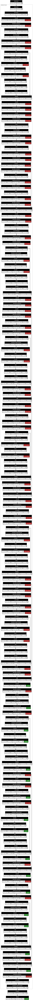

In [30]:
# Display a summary of the model 1 architecture
ft_model1.summary(expand_nested=True)

# Display model architecture with layer shapes and trainable parameters
tfk.utils.plot_model(ft_model1, expand_nested=True, show_trainable=True, show_shapes=True, dpi=70)

Model: "model2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 96, 96, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ MobilenetV3small (Functional)   │ (None, 576)            │       939,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ input_layer (InputLayer)   │ (None, 96, 96, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ rescaling (Rescaling)      │ (None, 96, 96, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ conv (Conv2D)              │ (None, 48, 48, 16)     │           432 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ conv_bn                    │ (None, 48, 48, 16)     │            64 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ activation (Activation)    │ (None, 48, 48, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └                            │ (None, 49, 49, 16)     │             0 │
│ expanded_conv_depthwise_pad     │                        │               │
│ (ZeroPadding2D)                 │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ expanded_conv_depthwise    │ (None, 24, 24, 16)     │           144 │
│ (DepthwiseConv2D)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ expanded_conv_depthwise_bn │ (None, 24, 24, 16)     │            64 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ re_lu (ReLU)               │ (None, 24, 24, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └                            │ (None, 1, 1, 16)       │             0 │
│ expanded_conv_squeeze_excite_a… │                        │               │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └                            │ (None, 1, 1, 8)        │           136 │
│ expanded_conv_squeeze_excite_c… │                        │               │
│ (Conv2D)                        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └                            │ (None, 1, 1, 8)        │             0 │
│ expanded_conv_squeeze_excite_r… │                        │               │
│ (ReLU)                          │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └                            │ (None, 1, 1, 16)       │           144 │
│ expanded_conv_squeeze_excite_c… │                        │               │
│ (Conv2D)                        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ re_lu_1 (ReLU)             │ (None, 1, 1, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └                            │ (None, 24, 24, 16)     │             0 │
│ expanded_conv_squeeze_excite_m… │                        │               │
│ (Multiply)                      │                        │               │
├─────────────────────────────────┼────────────────────────┼─────────────

 Total params: 1,841,802 (7.03 MB)

 Trainable params: 1,029,552 (3.93 MB)

 Non-trainable params: 211,144 (824.78 KB)

 Optimizer params: 601,106 (2.29 MB)

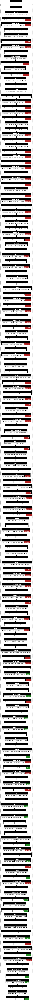

In [31]:
# Display a summary of the model 2 architecture
ft_model2.summary(expand_nested=True)

# Display model architecture with layer shapes and trainable parameters
tfk.utils.plot_model(ft_model2, expand_nested=True, show_trainable=True, show_shapes=True, dpi=70)

Model: "model3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 96, 96, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ MobilenetV3small (Functional)   │ (None, 576)            │       939,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ input_layer (InputLayer)   │ (None, 96, 96, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ rescaling (Rescaling)      │ (None, 96, 96, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ conv (Conv2D)              │ (None, 48, 48, 16)     │           432 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ conv_bn                    │ (None, 48, 48, 16)     │            64 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ activation (Activation)    │ (None, 48, 48, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └                            │ (None, 49, 49, 16)     │             0 │
│ expanded_conv_depthwise_pad     │                        │               │
│ (ZeroPadding2D)                 │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ expanded_conv_depthwise    │ (None, 24, 24, 16)     │           144 │
│ (DepthwiseConv2D)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ expanded_conv_depthwise_bn │ (None, 24, 24, 16)     │            64 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ re_lu (ReLU)               │ (None, 24, 24, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └                            │ (None, 1, 1, 16)       │             0 │
│ expanded_conv_squeeze_excite_a… │                        │               │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └                            │ (None, 1, 1, 8)        │           136 │
│ expanded_conv_squeeze_excite_c… │                        │               │
│ (Conv2D)                        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └                            │ (None, 1, 1, 8)        │             0 │
│ expanded_conv_squeeze_excite_r… │                        │               │
│ (ReLU)                          │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └                            │ (None, 1, 1, 16)       │           144 │
│ expanded_conv_squeeze_excite_c… │                        │               │
│ (Conv2D)                        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └ re_lu_1 (ReLU)             │ (None, 1, 1, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│    └                            │ (None, 24, 24, 16)     │             0 │
│ expanded_conv_squeeze_excite_m… │                        │               │
│ (Multiply)                      │                        │               │
├─────────────────────────────────┼────────────────────────┼─────────────

 Total params: 2,231,690 (8.51 MB)

 Trainable params: 1,159,344 (4.42 MB)

 Non-trainable params: 211,656 (826.78 KB)

 Optimizer params: 860,690 (3.28 MB)

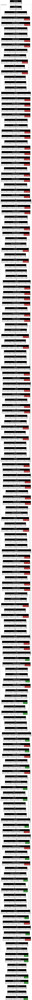

In [32]:
# Display a summary of the model 3 architecture
ft_model3.summary(expand_nested=True)

# Display model architecture with layer shapes and trainable parameters
tfk.utils.plot_model(ft_model3, expand_nested=True, show_trainable=True, show_shapes=True, dpi=70)

In [33]:
# Compile the model
ft_model1.compile(loss=tfk.losses.CategoricalCrossentropy(), optimizer=tfk.optimizers.Adam(1e-4), metrics=['accuracy'])
ft_model2.compile(loss=tfk.losses.CategoricalCrossentropy(), optimizer=tfk.optimizers.Adam(1e-4), metrics=['accuracy'])
ft_model3.compile(loss=tfk.losses.CategoricalCrossentropy(), optimizer=tfk.optimizers.Adam(1e-4), metrics=['accuracy'])

In [34]:
# Fine-tune the model 1
ft_history1 = ft_model1.fit(
    x=X_train,
    y=y_train,
    batch_size=batch_size,
    epochs=epochs,
    validation_data=(X_val, y_val),
    class_weight=class_weight_dict,
    callbacks=[early_stopping, reduce_lr]
).history

# Calculate and print the final validation accuracy
final_val_accuracy1 = round(max(ft_history1['val_accuracy']) * 100, 2)
print(f'Final validation accuracy 1: {final_val_accuracy1}%')

# Save the trained model to a file with the accuracy included in the filename
model_filename = 'MobileNetV3S_FT_' + str(final_val_accuracy1) + '.keras'
ft_model1.save(model_filename)

# Delete the model to free up resources
del ft_model1

Epoch 1/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 27s 44ms/step - accuracy: 0.6084 - loss: 1.1054 - val_accuracy: 0.6722 - val_loss: 0.9118 - learning_rate: 1.0000e-04
Epoch 2/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - accuracy: 0.6725 - loss: 0.9146 - val_accuracy: 0.6919 - val_loss: 0.8451 - learning_rate: 1.0000e-04
Epoch 3/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - accuracy: 0.7106 - loss: 0.8025 - val_accuracy: 0.7057 - val_loss: 0.8122 - learning_rate: 1.0000e-04
Epoch 4/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - accuracy: 0.7401 - loss: 0.7230 - val_accuracy: 0.7203 - val_loss: 0.7868 - learning_rate: 1.0000e-04
Epoch 5/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - accuracy: 0.7690 - loss: 0.6392 - val_accuracy: 0.7280 - val_loss: 0.7710 - learning_rate: 1.0000e-04
Epoch 6/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - accuracy: 0.7844 - loss: 0.5783 - val_accuracy: 0.7315 - val_loss: 0.7671 - learning_rate: 1.0000e-04
Epoch 7/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/st

In [35]:
# Fine-tune the model 2
ft_history2 = ft_model2.fit(
    x=X_train,
    y=y_train,
    batch_size=batch_size,
    epochs=epochs,
    validation_data=(X_val, y_val),
    class_weight=class_weight_dict,
    callbacks=[early_stopping, reduce_lr]
).history

# Calculate and print the final validation accuracy
final_val_accuracy2 = round(max(ft_history2['val_accuracy']) * 100, 2)
print(f'Final validation accuracy 2: {final_val_accuracy2}%')

# Save the trained model to a file with the accuracy included in the filename
model_filename = 'MobileNetV3S_FT_' + str(final_val_accuracy2) + '.keras'
ft_model2.save(model_filename)

# Delete the model to free up resources
del ft_model2

Epoch 1/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 27s 45ms/step - accuracy: 0.8819 - loss: 0.3043 - val_accuracy: 0.6841 - val_loss: 1.0404 - learning_rate: 1.0000e-04
Epoch 2/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - accuracy: 0.8996 - loss: 0.2624 - val_accuracy: 0.6826 - val_loss: 1.0638 - learning_rate: 1.0000e-04
Epoch 3/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - accuracy: 0.9094 - loss: 0.2337 - val_accuracy: 0.6840 - val_loss: 1.0367 - learning_rate: 1.0000e-04
Epoch 4/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - accuracy: 0.9221 - loss: 0.2079 - val_accuracy: 0.6965 - val_loss: 1.0353 - learning_rate: 1.0000e-04
Epoch 5/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - accuracy: 0.9322 - loss: 0.1852 - val_accuracy: 0.6971 - val_loss: 1.0334 - learning_rate: 1.0000e-04
Epoch 6/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - accuracy: 0.9350 - loss: 0.1765 - val_accuracy: 0.6989 - val_loss: 1.0389 - learning_rate: 1.0000e-04
Epoch 7/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/st

In [36]:
# Fine-tune the model 3
ft_history3 = ft_model3.fit(
    x=X_train,
    y=y_train,
    batch_size=batch_size,
    epochs=epochs,
    validation_data=(X_val, y_val),
    class_weight=class_weight_dict,
    callbacks=[early_stopping, reduce_lr]
).history

# Calculate and print the final validation accuracy
final_val_accuracy3 = round(max(ft_history3['val_accuracy']) * 100, 2)
print(f'Final validation accuracy 3: {final_val_accuracy3}%')

# Save the trained model to a file with the accuracy included in the filename
model_filename = 'MobileNetV3S_FT_' + str(final_val_accuracy3) + '.keras'
ft_model3.save(model_filename)

# Delete the model to free up resources
del ft_model3

Epoch 1/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 30s 49ms/step - accuracy: 0.5702 - loss: 1.2028 - val_accuracy: 0.6405 - val_loss: 0.9653 - learning_rate: 1.0000e-04
Epoch 2/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - accuracy: 0.6365 - loss: 0.9940 - val_accuracy: 0.6727 - val_loss: 0.8776 - learning_rate: 1.0000e-04
Epoch 3/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - accuracy: 0.6823 - loss: 0.8819 - val_accuracy: 0.6872 - val_loss: 0.8535 - learning_rate: 1.0000e-04
Epoch 4/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - accuracy: 0.7110 - loss: 0.7948 - val_accuracy: 0.6969 - val_loss: 0.8192 - learning_rate: 1.0000e-04
Epoch 5/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - accuracy: 0.7361 - loss: 0.7198 - val_accuracy: 0.7046 - val_loss: 0.8037 - learning_rate: 1.0000e-04
Epoch 6/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - accuracy: 0.7639 - loss: 0.6465 - val_accuracy: 0.7195 - val_loss: 0.7869 - learning_rate: 1.0000e-04
Epoch 7/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/st

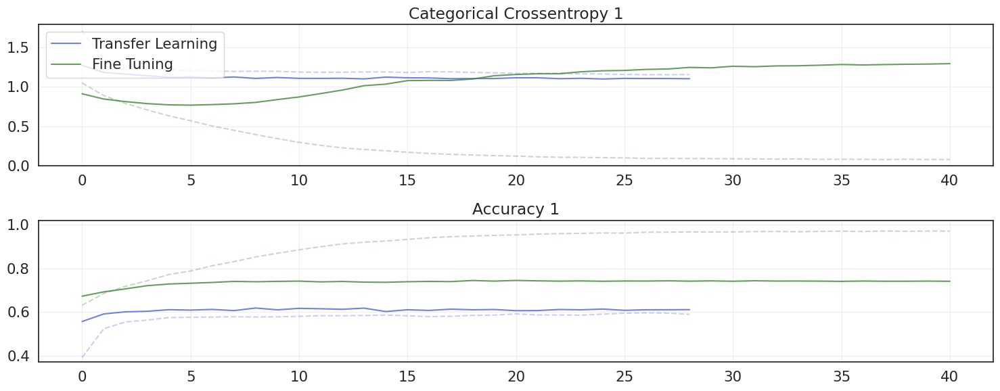

In [37]:
# Create figure and subplots for loss and accuracy
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(15, 6))

# Plot categorical cross-entropy loss for both Transfer Learning and Fine Tuning stages
ax1.plot(tl_history1['loss'], alpha=0.3, color='#4D61E2', linestyle='--')
ax1.plot(tl_history1['val_loss'], label='Transfer Learning', alpha=0.8, color='#4D61E2')
ax1.plot(ft_history1['loss'], alpha=0.3, color='#408537', linestyle='--')
ax1.plot(ft_history1['val_loss'], label='Fine Tuning', alpha=0.8, color='#408537')
ax1.set_title('Categorical Crossentropy 1')
ax1.legend(loc='upper left')
ax1.grid(alpha=0.3)

# Plot accuracy for both Transfer Learning and Fine Tuning stages
ax2.plot(tl_history1['accuracy'], alpha=0.3, color='#4D61E2', linestyle='--')
ax2.plot(tl_history1['val_accuracy'], label='Transfer Learning', alpha=0.8, color='#4D61E2')
ax2.plot(ft_history1['accuracy'], alpha=0.3, color='#408537', linestyle='--')
ax2.plot(ft_history1['val_accuracy'], label='Fine Tuning', alpha=0.8, color='#408537')
ax2.set_title('Accuracy 1')

# Dynamically calculate y-axis limits for accuracy
all_accuracies = (
    tl_history1['accuracy'] + 
    tl_history1['val_accuracy'] + 
    ft_history1['accuracy'] + 
    ft_history1['val_accuracy']
)
ax2.set_ylim([min(all_accuracies) * 0.95, max(all_accuracies) * 1.05])
ax2.grid(alpha=0.3)

# Adjust layout to prevent overlap and display the plots
plt.tight_layout()
plt.show()

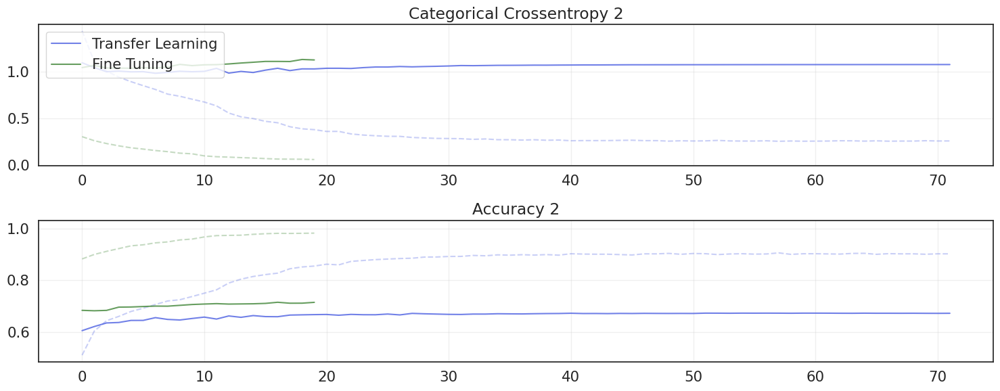

In [38]:
# Create figure and subplots for loss and accuracy
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(15, 6))

# Plot categorical cross-entropy loss for both Transfer Learning and Fine Tuning stages
ax1.plot(tl_history2['loss'], alpha=0.3, color='#4D61E2', linestyle='--')
ax1.plot(tl_history2['val_loss'], label='Transfer Learning', alpha=0.8, color='#4D61E2')
ax1.plot(ft_history2['loss'], alpha=0.3, color='#408537', linestyle='--')
ax1.plot(ft_history2['val_loss'], label='Fine Tuning', alpha=0.8, color='#408537')
ax1.set_title('Categorical Crossentropy 2')
ax1.legend(loc='upper left')
ax1.grid(alpha=0.3)

# Plot accuracy for both Transfer Learning and Fine Tuning stages
ax2.plot(tl_history2['accuracy'], alpha=0.3, color='#4D61E2', linestyle='--')
ax2.plot(tl_history2['val_accuracy'], label='Transfer Learning', alpha=0.8, color='#4D61E2')
ax2.plot(ft_history2['accuracy'], alpha=0.3, color='#408537', linestyle='--')
ax2.plot(ft_history2['val_accuracy'], label='Fine Tuning', alpha=0.8, color='#408537')
ax2.set_title('Accuracy 2')

# Dynamically calculate y-axis limits for accuracy
all_accuracies = (
    tl_history2['accuracy'] + 
    tl_history2['val_accuracy'] + 
    ft_history2['accuracy'] + 
    ft_history2['val_accuracy']
)
ax2.set_ylim([min(all_accuracies) * 0.95, max(all_accuracies) * 1.05])
ax2.grid(alpha=0.3)

# Adjust layout to prevent overlap and display the plots
plt.tight_layout()
plt.show()

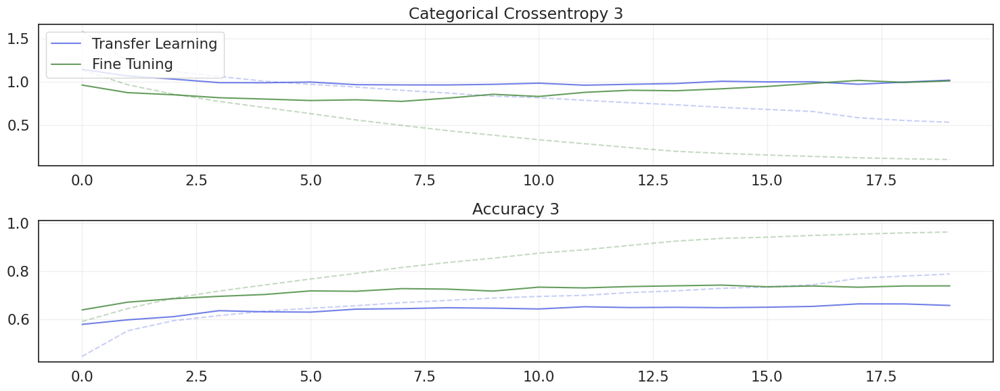

In [39]:
# Create figure and subplots for loss and accuracy
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(15, 6))

# Plot categorical cross-entropy loss for both Transfer Learning and Fine Tuning stages
ax1.plot(tl_history3['loss'], alpha=0.3, color='#4D61E2', linestyle='--')
ax1.plot(tl_history3['val_loss'], label='Transfer Learning', alpha=0.8, color='#4D61E2')
ax1.plot(ft_history3['loss'], alpha=0.3, color='#408537', linestyle='--')
ax1.plot(ft_history3['val_loss'], label='Fine Tuning', alpha=0.8, color='#408537')
ax1.set_title('Categorical Crossentropy 3')
ax1.legend(loc='upper left')
ax1.grid(alpha=0.3)

# Plot accuracy for both Transfer Learning and Fine Tuning stages
ax2.plot(tl_history3['accuracy'], alpha=0.3, color='#4D61E2', linestyle='--')
ax2.plot(tl_history3['val_accuracy'], label='Transfer Learning', alpha=0.8, color='#4D61E2')
ax2.plot(ft_history3['accuracy'], alpha=0.3, color='#408537', linestyle='--')
ax2.plot(ft_history3['val_accuracy'], label='Fine Tuning', alpha=0.8, color='#408537')
ax2.set_title('Accuracy 3')

# Dynamically calculate y-axis limits for accuracy
all_accuracies = (
    tl_history3['accuracy'] + 
    tl_history3['val_accuracy'] + 
    ft_history3['accuracy'] + 
    ft_history3['val_accuracy']
)
ax2.set_ylim([min(all_accuracies) * 0.95, max(all_accuracies) * 1.05])
ax2.grid(alpha=0.3)

# Adjust layout to prevent overlap and display the plots
plt.tight_layout()
plt.show()

## 🛠️ Final fine tuning
Unfreeze all layers

In [41]:
# Re-load the model after first fine tuning
ft_full_model1 = tfk.models.load_model('/kaggle/working/MobileNetV3S_FT_74.43.keras')  # model 1

# Unfreeze all layers
for i, layer in enumerate(ft_full_model1.get_layer('MobilenetV3small').layers[:N]):
    layer.trainable = True

# Set the BatchNorm layers as non-trainable
for layer in ft_full_model1.get_layer('MobilenetV3small').layers:
    if isinstance(layer, tf.keras.layers.BatchNormalization):
        layer.trainable = False

# Recompile the model
ft_full_model1.compile(
    loss=tfk.losses.CategoricalCrossentropy(),
    optimizer=tfk.optimizers.Adam(learning_rate=1e-5),
    metrics=['accuracy']
)

# Training with full fine tuning
ft_history1_full = ft_full_model1.fit(
    x=X_train,
    y=y_train,
    batch_size=batch_size,
    epochs=epochs,
    validation_data=(X_val, y_val),
    class_weight=class_weight_dict,
    callbacks=[early_stopping, reduce_lr]
).history

# Calculate and print the final validation accuracy
final_val_accuracy1_full = round(max(ft_history1_full['val_accuracy']) * 100, 2)
print(f'Final validation accuracy 1 (full): {final_val_accuracy1_full}%')

# Save the trained model to a file with the accuracy included in the filename
model_filename = 'MobileNetV3S_FTfull_' + str(final_val_accuracy1_full) + '.keras'
ft_full_model1.save(model_filename)

# Delete the model to free up resources
del ft_full_model1

Epoch 1/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 48s 85ms/step - accuracy: 0.9560 - loss: 0.1096 - val_accuracy: 0.7440 - val_loss: 1.1725 - learning_rate: 1.0000e-05
Epoch 2/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 22ms/step - accuracy: 0.9595 - loss: 0.1061 - val_accuracy: 0.7429 - val_loss: 1.1742 - learning_rate: 1.0000e-05
Epoch 3/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 22ms/step - accuracy: 0.9576 - loss: 0.1043 - val_accuracy: 0.7419 - val_loss: 1.1909 - learning_rate: 1.0000e-05
Epoch 4/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 22ms/step - accuracy: 0.9615 - loss: 0.0979 - val_accuracy: 0.7419 - val_loss: 1.1946 - learning_rate: 1.0000e-05
Epoch 5/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 22ms/step - accuracy: 0.9634 - loss: 0.0952 - val_accuracy: 0.7431 - val_loss: 1.2090 - learning_rate: 1.0000e-05
Epoch 6/200
334/337 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - accuracy: 0.9642 - loss: 0.0910
Epoch 6: ReduceLROnPlateau reducing learning rate to 4.999999873689376e-06.
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 22ms/step - a

In [42]:
# Re-load the model after first fine tuning
ft_full_model2 = tfk.models.load_model('/kaggle/working/MobileNetV3S_FT_71.53.keras')  # model 2

# Unfreeze all layers
for i, layer in enumerate(ft_full_model2.get_layer('MobilenetV3small').layers[:N]):
    layer.trainable = True

# Set the BatchNorm layers as non-trainable
for layer in ft_full_model2.get_layer('MobilenetV3small').layers:
    if isinstance(layer, tf.keras.layers.BatchNormalization):
        layer.trainable = False

# Recompile the model
ft_full_model2.compile(
    loss=tfk.losses.CategoricalCrossentropy(),
    optimizer=tfk.optimizers.Adam(learning_rate=1e-5),
    metrics=['accuracy']
)

# Training with full fine tuning
ft_history2_full = ft_full_model2.fit(
    x=X_train,
    y=y_train,
    batch_size=batch_size,
    epochs=epochs,
    validation_data=(X_val, y_val),
    class_weight=class_weight_dict,
    callbacks=[early_stopping, reduce_lr]
).history

# Calculate and print the final validation accuracy
final_val_accuracy2_full = round(max(ft_history2_full['val_accuracy']) * 100, 2)
print(f'Final validation accuracy 2 (full): {final_val_accuracy2_full}%')

# Save the trained model to a file with the accuracy included in the filename
model_filename = 'MobileNetV3S_FTfull_' + str(final_val_accuracy2_full) + '.keras'
ft_full_model2.save(model_filename)

# Delete the model to free up resources
del ft_full_model2

Epoch 1/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 47s 82ms/step - accuracy: 0.9046 - loss: 0.2446 - val_accuracy: 0.6887 - val_loss: 1.0173 - learning_rate: 1.0000e-05
Epoch 2/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 8s 22ms/step - accuracy: 0.9137 - loss: 0.2308 - val_accuracy: 0.6912 - val_loss: 1.0129 - learning_rate: 1.0000e-05
Epoch 3/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 8s 23ms/step - accuracy: 0.9149 - loss: 0.2184 - val_accuracy: 0.6951 - val_loss: 1.0087 - learning_rate: 1.0000e-05
Epoch 4/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 8s 22ms/step - accuracy: 0.9275 - loss: 0.2029 - val_accuracy: 0.6964 - val_loss: 1.0080 - learning_rate: 1.0000e-05
Epoch 5/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 8s 23ms/step - accuracy: 0.9196 - loss: 0.2037 - val_accuracy: 0.6986 - val_loss: 1.0049 - learning_rate: 1.0000e-05
Epoch 6/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 8s 23ms/step - accuracy: 0.9286 - loss: 0.1965 - val_accuracy: 0.6979 - val_loss: 1.0032 - learning_rate: 1.0000e-05
Epoch 7/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 8s 23ms/st

In [43]:
# Re-load the model after first fine tuning
ft_full_model3 = tfk.models.load_model('/kaggle/working/MobileNetV3S_FT_74.43.keras')  # model 3

# Unfreeze all layers
for i, layer in enumerate(ft_full_model3.get_layer('MobilenetV3small').layers[:N]):
    layer.trainable = True

# Set the BatchNorm layers as non-trainable
for layer in ft_full_model3.get_layer('MobilenetV3small').layers:
    if isinstance(layer, tf.keras.layers.BatchNormalization):
        layer.trainable = False
        
# Recompile the model
ft_full_model3.compile(
    loss=tfk.losses.CategoricalCrossentropy(),
    optimizer=tfk.optimizers.Adam(learning_rate=1e-5),
    metrics=['accuracy']
)

# Training with full fine tuning
ft_history3_full = ft_full_model3.fit(
    x=X_train,
    y=y_train,
    batch_size=batch_size,
    epochs=epochs,
    validation_data=(X_val, y_val),
    class_weight=class_weight_dict,
    callbacks=[early_stopping, reduce_lr]
).history

# Calculate and print the final validation accuracy
final_val_accuracy3_full = round(max(ft_history3_full['val_accuracy']) * 100, 2)
print(f'Final validation accuracy 3 (full): {final_val_accuracy3_full}%')

# Save the trained model to a file with the accuracy included in the filename
model_filename = 'MobileNetV3S_FTfull_' + str(final_val_accuracy3_full) + '.keras'
ft_full_model3.save(model_filename)

# Delete the model to free up resources
del ft_full_model3

Epoch 1/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 42s 75ms/step - accuracy: 0.9553 - loss: 0.1142 - val_accuracy: 0.7426 - val_loss: 1.1507 - learning_rate: 1.0000e-05
Epoch 2/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 22ms/step - accuracy: 0.9581 - loss: 0.1068 - val_accuracy: 0.7447 - val_loss: 1.1666 - learning_rate: 1.0000e-05
Epoch 3/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 22ms/step - accuracy: 0.9594 - loss: 0.1011 - val_accuracy: 0.7433 - val_loss: 1.1806 - learning_rate: 1.0000e-05
Epoch 4/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 22ms/step - accuracy: 0.9625 - loss: 0.0960 - val_accuracy: 0.7413 - val_loss: 1.1983 - learning_rate: 1.0000e-05
Epoch 5/200
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 22ms/step - accuracy: 0.9616 - loss: 0.0945 - val_accuracy: 0.7439 - val_loss: 1.2279 - learning_rate: 1.0000e-05
Epoch 6/200
334/337 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - accuracy: 0.9641 - loss: 0.0922
Epoch 6: ReduceLROnPlateau reducing learning rate to 4.999999873689376e-06.
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 22ms/step - a

## 🕹️ Use the Model - Make Inference

### Test model on test set

#### 1. Test set without augmentation

In [45]:
# Load the fine-tuned MobileNetV3 model for prediction on external images
ft_model1 = tfk.models.load_model('/kaggle/working/MobileNetV3S_FTfull_74.4.keras')
ft_model2 = tfk.models.load_model('/kaggle/working/MobileNetV3S_FTfull_70.7.keras')
ft_model3 = tfk.models.load_model('/kaggle/working/MobileNetV3S_FTfull_74.52.keras')

Accuracy 1 score over the test set: 0.9239
Precision 1 score over the test set: 0.9253
Recall score 1 over the test set: 0.9239
F1 score 1 over the test set: 0.9238


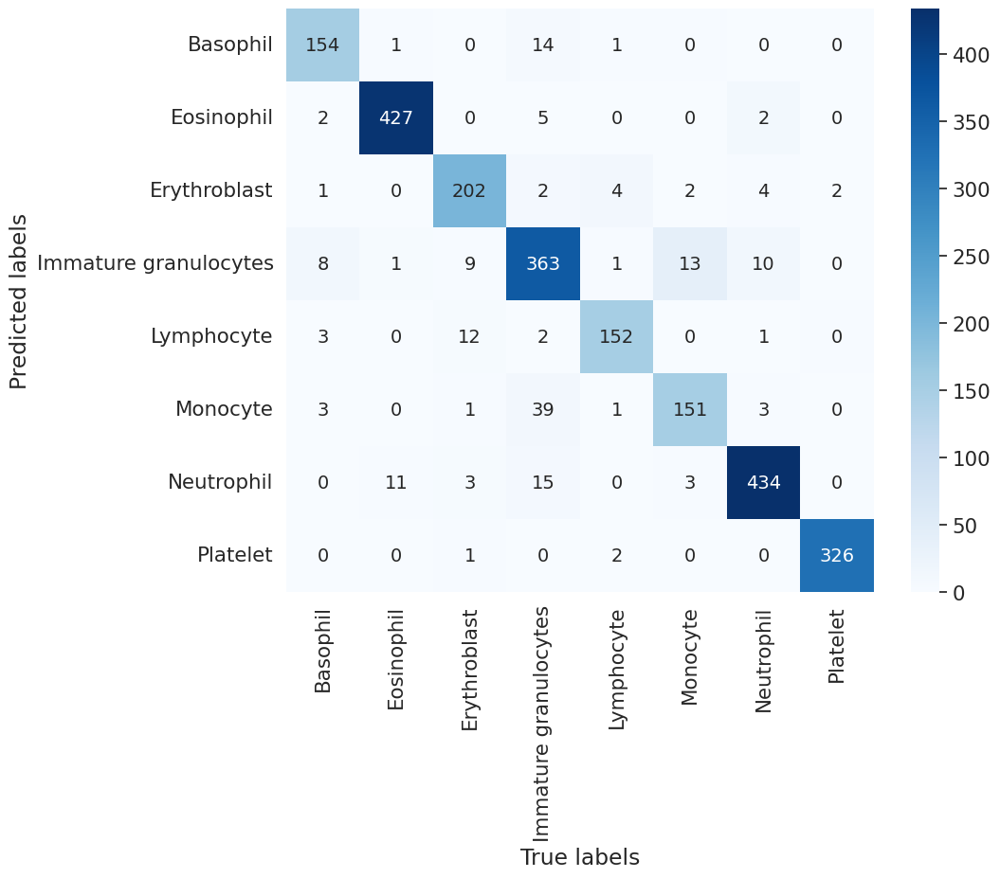

In [46]:
# Predict labels for the entire test set
predictions1 = ft_model1.predict(X_test, verbose=0)

# Convert predictions to class labels
pred_classes1 = np.argmax(predictions1, axis=-1)

# Extract ground truth classes
true_classes = np.argmax(y_test, axis=-1)

# Calculate and display test set accuracy
accuracy1 = accuracy_score(true_classes, pred_classes1)
print(f'Accuracy 1 score over the test set: {round(accuracy1, 4)}')

# Calculate and display test set precision
precision1 = precision_score(true_classes, pred_classes1, average='weighted')
print(f'Precision 1 score over the test set: {round(precision1, 4)}')

# Calculate and display test set recall
recall1 = recall_score(true_classes, pred_classes1, average='weighted')
print(f'Recall score 1 over the test set: {round(recall1, 4)}')

# Calculate and display test set F1 score
f11 = f1_score(true_classes, pred_classes1, average='weighted')
print(f'F1 score 1 over the test set: {round(f11, 4)}')

# Compute the confusion matrix
cm1 = confusion_matrix(true_classes, pred_classes1)

# Combine numbers and percentages into a single string for annotation
annot1 = np.array([f"{num}" for num in cm1.flatten()]).reshape(cm1.shape)

# Define class labels
labels = {0: "Basophil", 1: "Eosinophil", 2: "Erythroblast", 3: "Immature granulocytes",
          4: "Lymphocyte", 5: "Monocyte", 6: "Neutrophil", 7: "Platelet"}

# Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm1.T, annot=annot1, fmt='', xticklabels=list(labels.values()), yticklabels=list(labels.values()), cmap='Blues')
plt.xlabel('True labels')
plt.ylabel('Predicted labels')
plt.show()

Accuracy 2 score over the test set: 0.8791
Precision 2 score over the test set: 0.8854
Recall score 2 over the test set: 0.8791
F1 score 2 over the test set: 0.8788


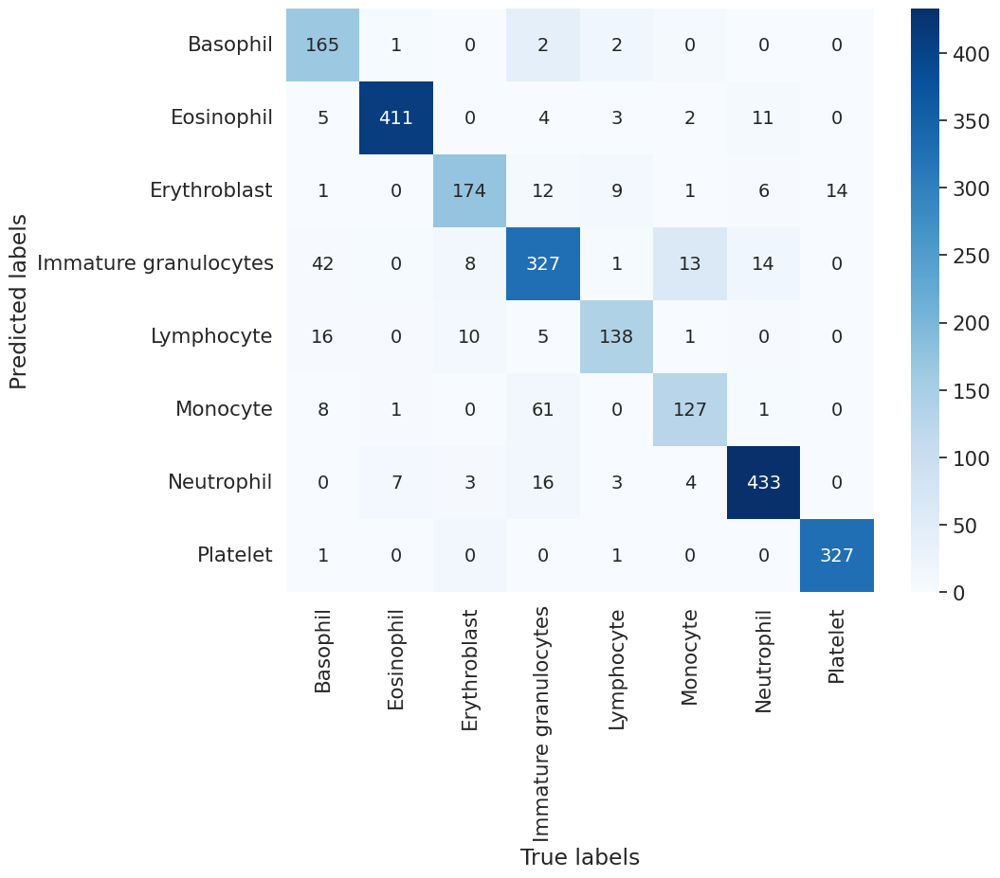

In [47]:
# Predict labels for the entire test set
predictions2 = ft_model2.predict(X_test, verbose=0)

# Convert predictions to class labels
pred_classes2 = np.argmax(predictions2, axis=-1)

# Extract ground truth classes
true_classes = np.argmax(y_test, axis=-1)

# Calculate and display test set accuracy
accuracy2 = accuracy_score(true_classes, pred_classes2)
print(f'Accuracy 2 score over the test set: {round(accuracy2, 4)}')

# Calculate and display test set precision
precision2 = precision_score(true_classes, pred_classes2, average='weighted')
print(f'Precision 2 score over the test set: {round(precision2, 4)}')

# Calculate and display test set recall
recall2 = recall_score(true_classes, pred_classes2, average='weighted')
print(f'Recall score 2 over the test set: {round(recall2, 4)}')

# Calculate and display test set F1 score
f12 = f1_score(true_classes, pred_classes2, average='weighted')
print(f'F1 score 2 over the test set: {round(f12, 4)}')

# Compute the confusion matrix
cm2 = confusion_matrix(true_classes, pred_classes2)

# Combine numbers and percentages into a single string for annotation
annot2 = np.array([f"{num}" for num in cm2.flatten()]).reshape(cm2.shape)

# Define class labels
labels = {0: "Basophil", 1: "Eosinophil", 2: "Erythroblast", 3: "Immature granulocytes",
          4: "Lymphocyte", 5: "Monocyte", 6: "Neutrophil", 7: "Platelet"}

# Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm2.T, annot=annot2, fmt='', xticklabels=list(labels.values()), yticklabels=list(labels.values()), cmap='Blues')
plt.xlabel('True labels')
plt.ylabel('Predicted labels')
plt.show()

Accuracy 3 score over the test set: 0.9247
Precision 3 score over the test set: 0.9266
Recall score 3 over the test set: 0.9247
F1 score 3 over the test set: 0.9244


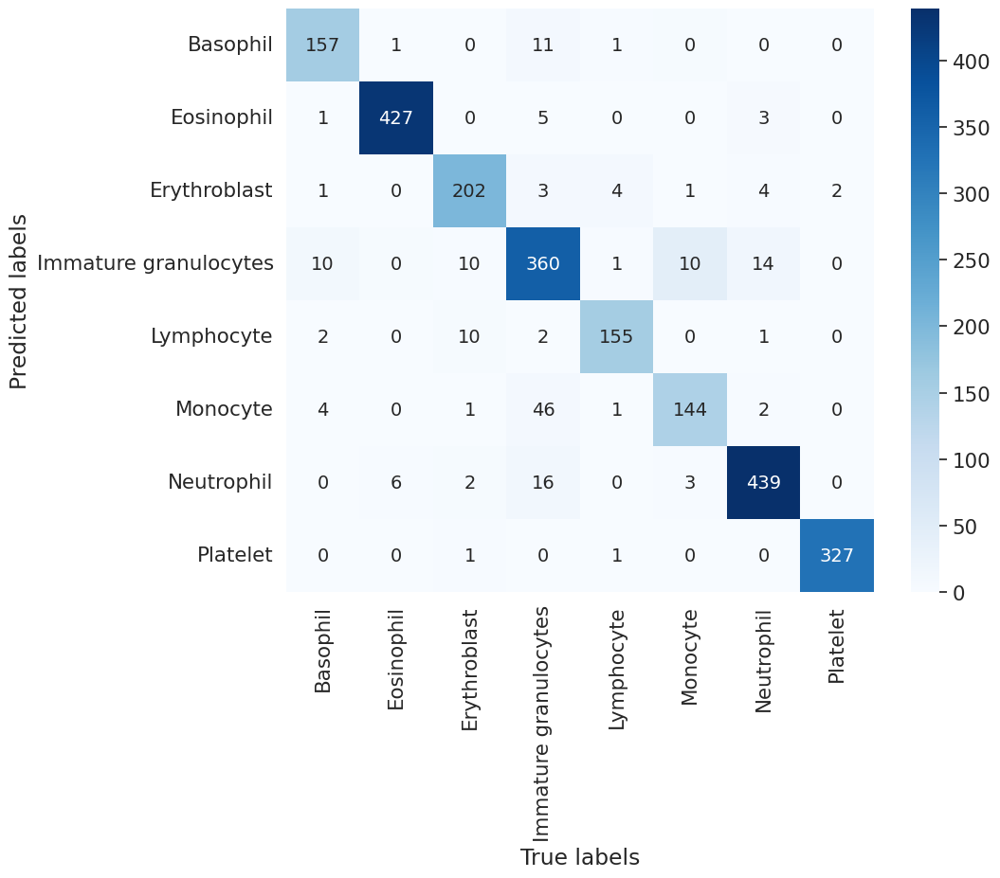

In [48]:
# Predict labels for the entire test set
predictions3 = ft_model3.predict(X_test, verbose=0)

# Convert predictions to class labels
pred_classes3 = np.argmax(predictions3, axis=-1)

# Extract ground truth classes
true_classes = np.argmax(y_test, axis=-1)

# Calculate and display test set accuracy
accuracy3 = accuracy_score(true_classes, pred_classes3)
print(f'Accuracy 3 score over the test set: {round(accuracy3, 4)}')

# Calculate and display test set precision
precision3 = precision_score(true_classes, pred_classes3, average='weighted')
print(f'Precision 3 score over the test set: {round(precision3, 4)}')

# Calculate and display test set recall
recall3 = recall_score(true_classes, pred_classes3, average='weighted')
print(f'Recall score 3 over the test set: {round(recall3, 4)}')

# Calculate and display test set F1 score
f13 = f1_score(true_classes, pred_classes3, average='weighted')
print(f'F1 score 3 over the test set: {round(f13, 4)}')

# Compute the confusion matrix
cm3 = confusion_matrix(true_classes, pred_classes3)

# Combine numbers and percentages into a single string for annotation
annot3 = np.array([f"{num}" for num in cm3.flatten()]).reshape(cm3.shape)

# Define class labels
labels = {0: "Basophil", 1: "Eosinophil", 2: "Erythroblast", 3: "Immature granulocytes",
          4: "Lymphocyte", 5: "Monocyte", 6: "Neutrophil", 7: "Platelet"}

# Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm3.T, annot=annot3, fmt='', xticklabels=list(labels.values()), yticklabels=list(labels.values()), cmap='Blues')
plt.xlabel('True labels')
plt.ylabel('Predicted labels')
plt.show()

#### 2. Test set with augmentation

Accuracy 1 score over the test set augmented: 0.6207
Precision 1 score over the test set augmented: 0.6206
Recall score 1 over the test set augmented: 0.6207
F1 score 1 over the test set augmented: 0.6176


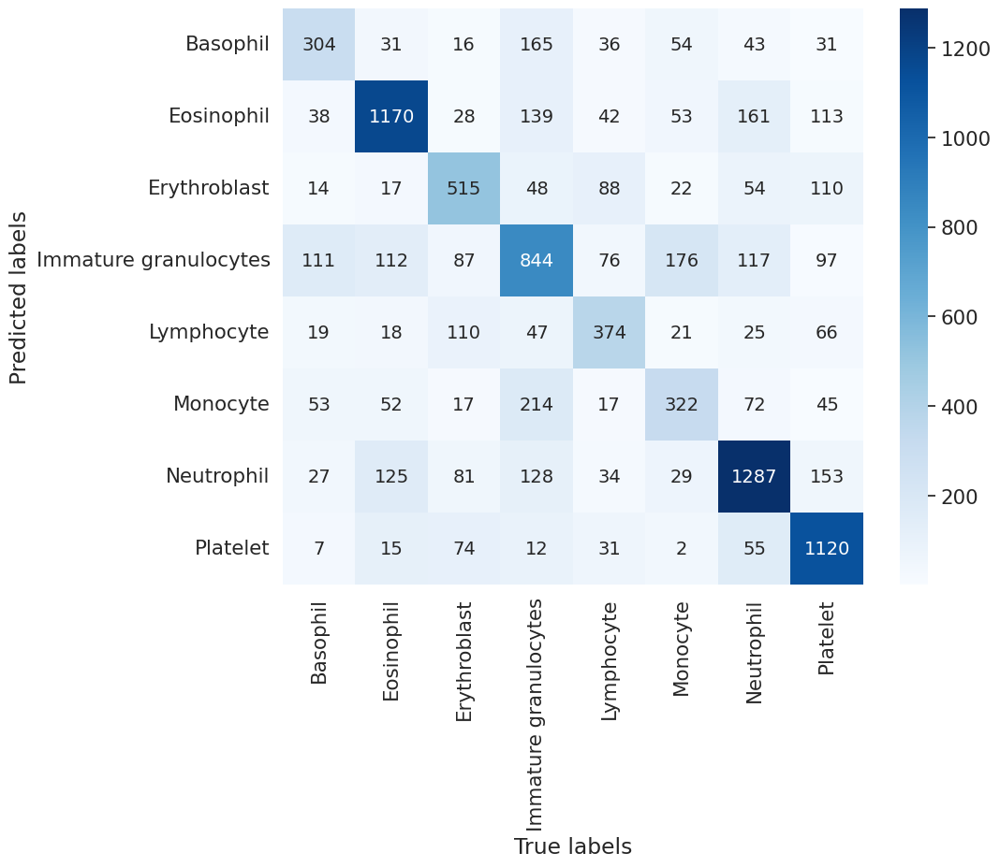

In [49]:
# Predict labels for the entire test set
predictions1_aug = ft_model1.predict(X_test_augmented, verbose=0)

# Convert predictions to class labels
pred_classes1_aug = np.argmax(predictions1_aug, axis=-1)

# Extract ground truth classes
true_classes_aug = np.argmax(y_test_augmented, axis=-1)

# Calculate and display test set accuracy
accuracy1_aug = accuracy_score(true_classes_aug, pred_classes1_aug)
print(f'Accuracy 1 score over the test set augmented: {round(accuracy1_aug, 4)}')

# Calculate and display test set precision
precision1_aug = precision_score(true_classes_aug, pred_classes1_aug, average='weighted')
print(f'Precision 1 score over the test set augmented: {round(precision1_aug, 4)}')

# Calculate and display test set recall
recall1_aug = recall_score(true_classes_aug, pred_classes1_aug, average='weighted')
print(f'Recall score 1 over the test set augmented: {round(recall1_aug, 4)}')

# Calculate and display test set F1 score
f11_aug = f1_score(true_classes_aug, pred_classes1_aug, average='weighted')
print(f'F1 score 1 over the test set augmented: {round(f11_aug, 4)}')

# Compute the confusion matrix
cm1_aug = confusion_matrix(true_classes_aug, pred_classes1_aug)

# Combine numbers and percentages into a single string for annotation
annot1_aug = np.array([f"{num}" for num in cm1_aug.flatten()]).reshape(cm1_aug.shape)

# Define class labels
labels = {0: "Basophil", 1: "Eosinophil", 2: "Erythroblast", 3: "Immature granulocytes",
          4: "Lymphocyte", 5: "Monocyte", 6: "Neutrophil", 7: "Platelet"}

# Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm1_aug.T, annot=annot1_aug, fmt='', xticklabels=list(labels.values()), yticklabels=list(labels.values()), cmap='Blues')
plt.xlabel('True labels')
plt.ylabel('Predicted labels')
plt.show()

Accuracy 2 score over the test set augmented: 0.569
Precision 2 score over the test set augmented: 0.5761
Recall score 2 over the test set augmented: 0.569
F1 score 2 over the test set augmented: 0.5702


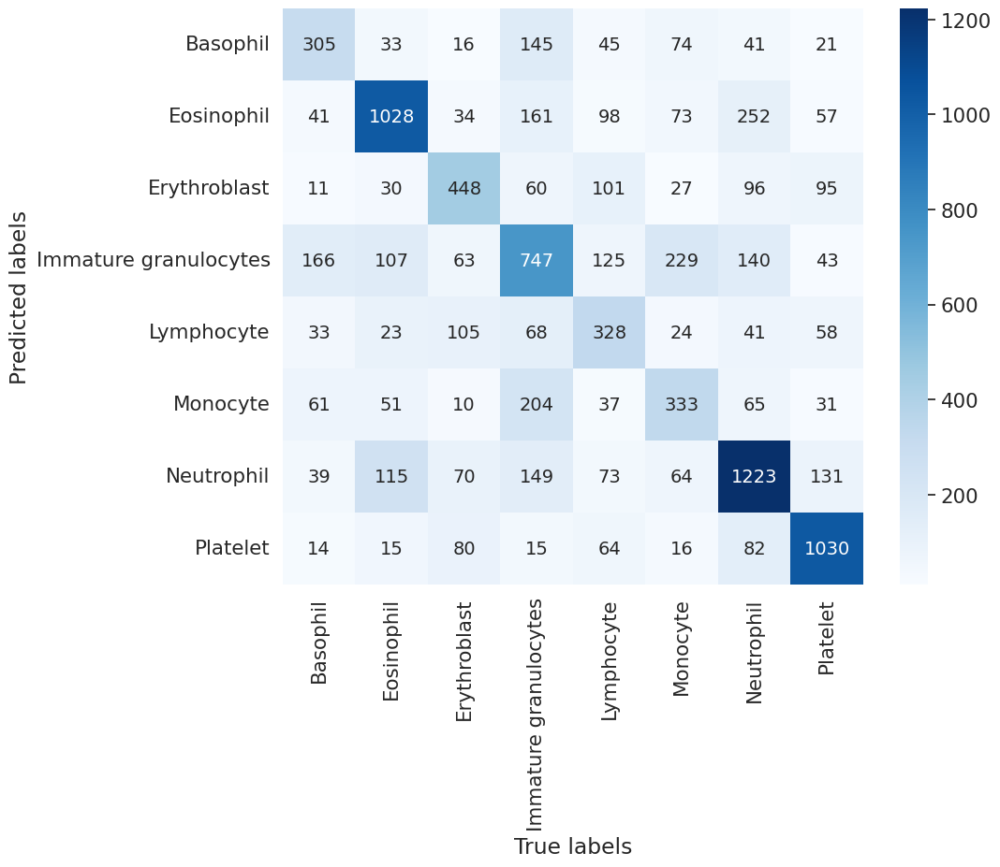

In [50]:
# Predict labels for the entire test set
predictions2_aug = ft_model2.predict(X_test_augmented, verbose=0)

# Convert predictions to class labels
pred_classes2_aug = np.argmax(predictions2_aug, axis=-1)

# Extract ground truth classes
true_classes_aug = np.argmax(y_test_augmented, axis=-1)

# Calculate and display test set accuracy
accuracy2_aug = accuracy_score(true_classes_aug, pred_classes2_aug)
print(f'Accuracy 2 score over the test set augmented: {round(accuracy2_aug, 4)}')

# Calculate and display test set precision
precision2_aug = precision_score(true_classes_aug, pred_classes2_aug, average='weighted')
print(f'Precision 2 score over the test set augmented: {round(precision2_aug, 4)}')

# Calculate and display test set recall
recall2_aug = recall_score(true_classes_aug, pred_classes2_aug, average='weighted')
print(f'Recall score 2 over the test set augmented: {round(recall2_aug, 4)}')

# Calculate and display test set F1 score
f12_aug = f1_score(true_classes_aug, pred_classes2_aug, average='weighted')
print(f'F1 score 2 over the test set augmented: {round(f12_aug, 4)}')

# Compute the confusion matrix
cm2_aug = confusion_matrix(true_classes_aug, pred_classes2_aug)

# Combine numbers and percentages into a single string for annotation
annot2_aug = np.array([f"{num}" for num in cm2_aug.flatten()]).reshape(cm2_aug.shape)

# Define class labels
labels = {0: "Basophil", 1: "Eosinophil", 2: "Erythroblast", 3: "Immature granulocytes",
          4: "Lymphocyte", 5: "Monocyte", 6: "Neutrophil", 7: "Platelet"}

# Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm2_aug.T, annot=annot2_aug, fmt='', xticklabels=list(labels.values()), yticklabels=list(labels.values()), cmap='Blues')
plt.xlabel('True labels')
plt.ylabel('Predicted labels')
plt.show()

Accuracy 3 score over the test set augmented: 0.6215
Precision 3 score over the test set augmented: 0.623
Recall score 3 over the test set augmented: 0.6215
F1 score 3 over the test set augmented: 0.6192


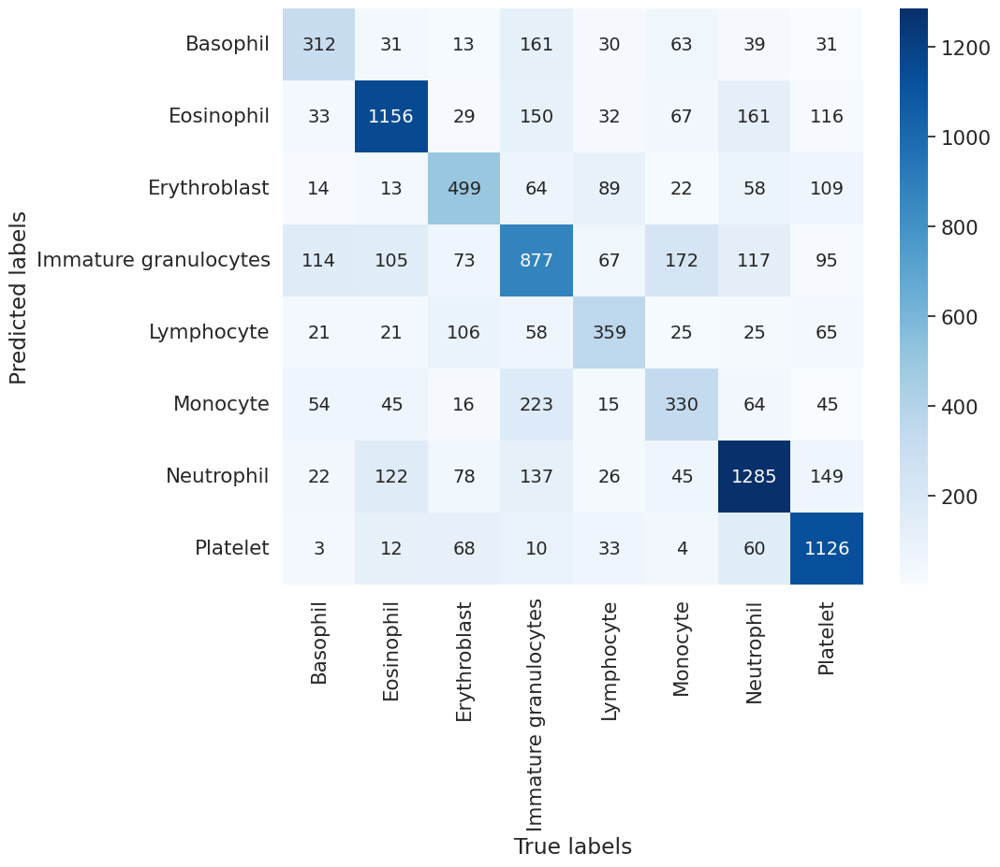

In [51]:
# Predict labels for the entire test set
predictions3_aug = ft_model3.predict(X_test_augmented, verbose=0)

# Convert predictions to class labels
pred_classes3_aug = np.argmax(predictions3_aug, axis=-1)

# Extract ground truth classes
true_classes_aug = np.argmax(y_test_augmented, axis=-1)

# Calculate and display test set accuracy
accuracy3_aug = accuracy_score(true_classes_aug, pred_classes3_aug)
print(f'Accuracy 3 score over the test set augmented: {round(accuracy3_aug, 4)}')

# Calculate and display test set precision
precision3_aug = precision_score(true_classes_aug, pred_classes3_aug, average='weighted')
print(f'Precision 3 score over the test set augmented: {round(precision3_aug, 4)}')

# Calculate and display test set recall
recall3_aug = recall_score(true_classes_aug, pred_classes3_aug, average='weighted')
print(f'Recall score 3 over the test set augmented: {round(recall3_aug, 4)}')

# Calculate and display test set F1 score
f13_aug = f1_score(true_classes_aug, pred_classes3_aug, average='weighted')
print(f'F1 score 3 over the test set augmented: {round(f13_aug, 4)}')

# Compute the confusion matrix
cm3_aug = confusion_matrix(true_classes_aug, pred_classes3_aug)

# Combine numbers and percentages into a single string for annotation
annot3_aug = np.array([f"{num}" for num in cm3_aug.flatten()]).reshape(cm3_aug.shape)

# Define class labels
labels = {0: "Basophil", 1: "Eosinophil", 2: "Erythroblast", 3: "Immature granulocytes",
          4: "Lymphocyte", 5: "Monocyte", 6: "Neutrophil", 7: "Platelet"}

# Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm3_aug.T, annot=annot3_aug, fmt='', xticklabels=list(labels.values()), yticklabels=list(labels.values()), cmap='Blues')
plt.xlabel('True labels')
plt.ylabel('Predicted labels')
plt.show()

## 📊 Prepare Your Submission

To prepare your submission, create a `.zip` file that includes all the necessary code to run your model. It **must** include a `model.py` file with the following class:

```python

# file: model.py

import tensorflow as tf
import numpy as np

class Model:
    def __init__(self):
        """Initialize the internal state of the model."""

        # Load the pre-trained model weights
        self.model = tf.keras.models.load_model('weights.keras')  # Path to your saved weights

    def predict(self, X):
        """
        Return a numpy array with the labels corresponding to the input X.
        X: numpy array of input images.
        """
        predictions = self.model.predict(X)
        # Return the class labels as a numpy array
        return np.argmax(predictions, axis=-1)

The next cell shows an example implementation of the `model.py` file, which includes loading model weights from the `weights.keras` file and conducting predictions on provided input data. The `.zip` file is created and downloaded in the last notebook cell.

❗ Feel free to modify the method implementations to better fit your specific requirements, but please ensure that the class name and method interfaces remain unchanged.

In [1]:
%%writefile model.py

import numpy as np
import tensorflow as tf
from tensorflow import keras as tfk
from tensorflow.keras import layers as tfkl

class Model:
    def __init__(self):
        """
        Initialize the internal state of the model. Note that the __init__
        method cannot accept any arguments.
        """
        # Load the specific model file
        self.neural_network = tfk.models.load_model('MobileNetV3S_FTfull_74.52.keras')

    def predict(self, X):
        """
        Predict the labels corresponding to the input X. Note that X is a numpy
        array of shape (n_samples, 96, 96, 3) and the output should be a numpy
        array of shape (n_samples,). Therefore, outputs must not be one-hot
        encoded.

        This function returns class labels as integers.
        """
        # Get predictions and convert to label format
        preds = self.neural_network.predict(X)
        if len(preds.shape) == 2:
            preds = np.argmax(preds, axis=1)
        return preds

Writing model.py


In [2]:
from datetime import datetime

filename = f'submission_{datetime.now().strftime("%y%m%d_%H%M%S")}.zip'

# Add files to the zip command if needed
!zip {filename} model.py MobileNetV3S_FTfull_74.52.keras

  adding: model.py (deflated 52%)
  adding: MobileNetV3S_FTfull_74.52.keras (deflated 12%)
